# Exploration de la station RATP Roosevelt

#### Ce notebook a comme but l'exploration des données de qualité de l'air et météo de la station Rooselvelt fournies par la RATP

A la fin de cette exploration, nous pourrons aussi sortir une liste de toutes les anomalies trouvés ou tous les élements dont il faudra prendre une décision. 

## Libraries à importer

In [87]:
library("IRdisplay") #used to show png file 
library("tidyverse")

## Variables globales

In [88]:
DATA_PATH="C://Formation IA//CEPE//Projet//QAIR//Data//"
DATA_FILE="RATP_qair_2013_2020.csv"

## Lecture des données

D'abord, nous allons récupérer les données que nous avions téléchargée à travers de JSON

In [89]:
fichier_donnees=paste(DATA_PATH,DATA_FILE,sep="")
df<-read.csv(fichier_donnees)

In [90]:
df

X,X10fra1,dateheure,tfra1,n2fra1,hyfra1,nofra1,c2fra1
1,26,2013-01-01T01:00:00+00:00,15.1,41,65.6,23,612
2,18,2013-01-01T02:00:00+00:00,14.9,61,65.0,43,536
3,45,2013-01-01T03:00:00+00:00,14.9,52,63.3,22,490
4,22,2013-01-01T04:00:00+00:00,14.9,56,63.7,27,481
5,15,2013-01-01T05:00:00+00:00,15.0,57,63.3,27,464
6,17,2013-01-01T06:00:00+00:00,15.1,50,63.2,20,455
7,17,2013-01-01T07:00:00+00:00,14.9,51,63.7,24,442
8,20,2013-01-01T08:00:00+00:00,14.8,37,64.1,10,426
9,13,2013-01-01T09:00:00+00:00,14.5,40,64.0,11,427
10,7,2013-01-01T10:00:00+00:00,14.4,42,61.7,11,431


## Exploration des données

Nous allons profiter du code d'exploration des données de la RATP pour récuperer les infos retrouvées sur les heures.

### Première exploration

A première vue

In [91]:
head(df)

X,X10fra1,dateheure,tfra1,n2fra1,hyfra1,nofra1,c2fra1
1,26,2013-01-01T01:00:00+00:00,15.1,41,65.6,23,612
2,18,2013-01-01T02:00:00+00:00,14.9,61,65.0,43,536
3,45,2013-01-01T03:00:00+00:00,14.9,52,63.3,22,490
4,22,2013-01-01T04:00:00+00:00,14.9,56,63.7,27,481
5,15,2013-01-01T05:00:00+00:00,15.0,57,63.3,27,464
6,17,2013-01-01T06:00:00+00:00,15.1,50,63.2,20,455


Nous observons que les nommes des colonnes ne semblent pas trop parlants, il faudra les renommer.

#### Validation des données

##### Nous pouvons comparer cette vue des données avec celle présentée au site : 

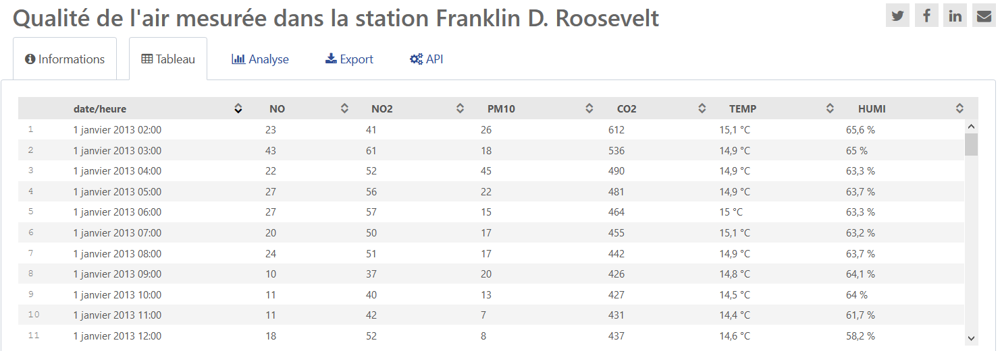

In [92]:
file_name_capture_RATP="capture RATP Roosevelt.PNG"
file_capture_RATP=paste(DATA_PATH,file_name_capture_RATP,sep="")
display_png(file=file_capture_RATP)  

Nous pouvons constater que le registre du 1/1/2013 01:00 du fichier JSON corresponde avec le registre du 1/1/2013 du 2:00 de la vue capturée. En plus dans le site du RATP les données commencent à partir du 2:00 AM du 1/1/2013 lorsque dans le fichier JSON il commencent à 01:00.

Comme nous avons aussi le csv directement récupéré du site, nous allons le comparer également : 

In [93]:
fichier_csv_site="download du site qualite-de-lair-mesuree-dans-la-station-franklin-d-roosevelt.csv"
fichier_donnees_site=paste(DATA_PATH,fichier_csv_site,sep="")
df_site<-read.csv(fichier_donnees_site,sep=";",header=FALSE)
head(df_site)

V1,V2,V3,V4,V5,V6,V7
2013-01-01T02:00:00+01:00,23,41,26,612,15.1,65.6
2013-01-01T03:00:00+01:00,43,61,18,536,14.9,65.0
2013-01-01T04:00:00+01:00,22,52,45,490,14.9,63.3
2013-01-01T05:00:00+01:00,27,56,22,481,14.9,63.7
2013-01-01T06:00:00+01:00,27,57,15,464,15.0,63.3
2013-01-01T07:00:00+01:00,20,50,17,455,15.1,63.2


** Le csv provennant du site semble correspondre à la capture, donc notre JSON fait un traitement avec les dates et heures qu'il faudra comprendre ou bien il faut peut être interpréter correctement les heures**

##### Nombre de registres attendu ?

In [94]:
nrow(df)

[1] 70068

Selon la RATP nous devrions avoir : 

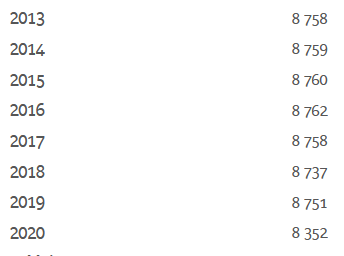

In [95]:
file_name_capture_RATP_nrow="Capture RATP nrow.PNG"
file_capture_RATP_nrow=paste(DATA_PATH,file_name_capture_RATP_nrow,sep="")
display_png(file=file_capture_RATP_nrow)  

Qui corresponde bien à notre numéro de lignes

In [96]:
8758+8759+8760+8762+8758+8737+8751+8352

[1] 69637

Regardons le nombre de registre par année dans notre dataset : 

In [97]:
table(df$dateheure %>% substr(1,4))


2013 2014 2015 2016 2017 2018 2019 2020 
8759 8759 8760 8761 8759 8736 8752 8782 

Ca ne corresponde pas tout à fait, certainement à cause des différences de critère des dates et heures.

##### Résumée des variables

In [98]:
summary(df)

       X            X10fra1                           dateheure    
 Min.   :    1   Min.   :  5.00   2019-10-27T02:00:00+00:00:    2  
 1st Qu.:17518   1st Qu.: 23.00   2013-01-01T01:00:00+00:00:    1  
 Median :35035   Median : 35.00   2013-01-01T02:00:00+00:00:    1  
 Mean   :35035   Mean   : 45.72   2013-01-01T03:00:00+00:00:    1  
 3rd Qu.:52551   3rd Qu.: 53.00   2013-01-01T04:00:00+00:00:    1  
 Max.   :70068   Max.   :979.00   2013-01-01T05:00:00+00:00:    1  
                 NA's   :3912     (Other)                  :70061  
     tfra1           n2fra1           hyfra1          nofra1      
 Min.   : 3.80   Min.   :  4.00   Min.   :13.10   Min.   :  1.00  
 1st Qu.:15.60   1st Qu.: 39.00   1st Qu.:40.70   1st Qu.: 10.00  
 Median :18.90   Median : 54.00   Median :47.60   Median : 23.00  
 Mean   :19.26   Mean   : 54.91   Mean   :47.85   Mean   : 37.33  
 3rd Qu.:23.00   3rd Qu.: 69.00   3rd Qu.:54.90   3rd Qu.: 49.00  
 Max.   :35.20   Max.   :265.00   Max.   :95.40   Max.

#### Préparation des dates et heures

On vérifie les doublés :

In [99]:
n_occur <- data.frame(table(df$dateheure))
n_occur[n_occur$Freq > 1,]

,Var1,Freq
59705,2019-10-27T02:00:00+00:00,2


Ce n'est pas normal qu'on trouve un dupliqué que pour 2019, c'est comme ci nous avions des heures UTC sauf pour 2019 qui serait en local.

Nous allons étudier toutes les annnées séparement

In [100]:
year_table<-list()
for (year_ind in 2013:2020)
{
    aux_ind<-df$dateheure %>% substr(1,4)==year_ind
    year_table[[year_ind]]<-as.POSIXct(df$dateheure[aux_ind],format="%Y-%m-%dT%H:%M:%OS",tz="GMT")
}

In [101]:
year_table[[2013]]

   [1] "2013-01-01 01:00:00 GMT" "2013-01-01 02:00:00 GMT"
   [3] "2013-01-01 03:00:00 GMT" "2013-01-01 04:00:00 GMT"
   [5] "2013-01-01 05:00:00 GMT" "2013-01-01 06:00:00 GMT"
   [7] "2013-01-01 07:00:00 GMT" "2013-01-01 08:00:00 GMT"
   [9] "2013-01-01 09:00:00 GMT" "2013-01-01 10:00:00 GMT"
  [11] "2013-01-01 11:00:00 GMT" "2013-01-01 12:00:00 GMT"
  [13] "2013-01-01 13:00:00 GMT" "2013-01-01 14:00:00 GMT"
  [15] "2013-01-01 15:00:00 GMT" "2013-01-01 16:00:00 GMT"
  [17] "2013-01-01 17:00:00 GMT" "2013-01-01 18:00:00 GMT"
  [19] "2013-01-01 19:00:00 GMT" "2013-01-01 20:00:00 GMT"
  [21] "2013-01-01 21:00:00 GMT" "2013-01-01 22:00:00 GMT"
  [23] "2013-01-01 23:00:00 GMT" "2013-01-02 00:00:00 GMT"
  [25] "2013-01-02 01:00:00 GMT" "2013-01-02 02:00:00 GMT"
  [27] "2013-01-02 03:00:00 GMT" "2013-01-02 04:00:00 GMT"
  [29] "2013-01-02 05:00:00 GMT" "2013-01-02 06:00:00 GMT"
  [31] "2013-01-02 07:00:00 GMT" "2013-01-02 08:00:00 GMT"
  [33] "2013-01-02 09:00:00 GMT" "2013-01-02 10:00:00 GM

Min et Max de chaque année

In [102]:
for (year_ind in 2013:2020)
{
    print(year_ind)
    print(min(year_table[[year_ind]]))
    print(max(year_table[[year_ind]]))
}

[1] 2013
[1] "2013-01-01 01:00:00 GMT"
[1] "2013-12-31 23:00:00 GMT"
[1] 2014
[1] "2014-01-01 GMT"
[1] "2014-12-31 23:00:00 GMT"
[1] 2015
[1] "2015-01-01 GMT"
[1] "2015-12-31 23:00:00 GMT"
[1] 2016
[1] "2016-01-01 GMT"
[1] "2016-12-31 GMT"
[1] 2017
[1] "2017-01-01 01:00:00 GMT"
[1] "2017-12-31 23:00:00 GMT"
[1] 2018
[1] "2018-01-01 01:00:00 GMT"
[1] "2018-12-31 GMT"
[1] 2019
[1] "2019-01-01 GMT"
[1] "2019-12-31 23:00:00 GMT"
[1] 2020
[1] "2020-01-01 GMT"
[1] "2020-12-31 23:00:00 GMT"


Pour quoi le minimum de 2014, 2015, 2016 et 2019 n'ont pas d'heure. On revient aux données à la source

In [103]:
df$dateheure[df$dateheure %>% substr(1,4)==2014]

[1] 2014-01-01T00:00:00+00:00 2014-01-01T01:00:00+00:00
   [3] 2014-01-01T02:00:00+00:00 2014-01-01T03:00:00+00:00
   [5] 2014-01-01T04:00:00+00:00 2014-01-01T05:00:00+00:00
   [7] 2014-01-01T06:00:00+00:00 2014-01-01T07:00:00+00:00
   [9] 2014-01-01T08:00:00+00:00 2014-01-01T09:00:00+00:00
  [11] 2014-01-01T10:00:00+00:00 2014-01-01T11:00:00+00:00
  [13] 2014-01-01T12:00:00+00:00 2014-01-01T13:00:00+00:00
  [15] 2014-01-01T14:00:00+00:00 2014-01-01T15:00:00+00:00
  [17] 2014-01-01T16:00:00+00:00 2014-01-01T17:00:00+00:00
  [19] 2014-01-01T18:00:00+00:00 2014-01-01T19:00:00+00:00
  [21] 2014-01-01T20:00:00+00:00 2014-01-01T21:00:00+00:00
  [23] 2014-01-01T22:00:00+00:00 2014-01-01T23:00:00+00:00
  [25] 2014-01-02T00:00:00+00:00 2014-01-02T01:00:00+00:00
  [27] 2014-01-02T02:00:00+00:00 2014-01-02T03:00:00+00:00
  [29] 2014-01-02T04:00:00+00:00 2014-01-02T05:00:00+00:00
  [31] 2014-01-02T06:00:00+00:00 2014-01-02T07:00:00+00:00
  [33] 2014-01-02T08:00:00+00:00 2014-01-02T09:00:00+00:00
  [35] 2014-01-02T10:00:00+00:00 2014-01-02T11:00:00+00:00
  [37] 2014-01-02T12:00:00+00:00 2014-01-02T13:00:00+00:00
  [39] 2014-01-02T14:00:00+00:00 2014-01-02T15:00:00+00:00
  [41] 2014-01-02T16:00:00+00:00 2014-01-02T17:00:00+00:00
  [43] 2014-01-02T18:00:00+00:00 2014-01-02T19:00:00+00:00
  [45] 2014-01-02T20:00:00+00:00 2014-01-02T21:00:00+00:00
  [47] 2014-01-02T22:00:00+00:00 2014-01-02T23:00:00+00:00
  [49] 2014-01-03T00:00:00+00:00 2014-01-03T01:00:00+00:00
  [51] 2014-01-03T02:00:00+00:00 2014-01-03T03:00:00+00:00
  [53] 2014-01-03T04:00:00+00:00 2014-01-03T05:00:00+00:00
  [55] 2014-01-03T06:00:00+00:00 2014-01-03T07:00:00+00:00
  [57] 2014-01-03T08:00:00+00:00 2014-01-03T09:00:00+00:00
  [59] 2014-01-03T10:00:00+00:00 2014-01-03T11:00:00+00:00
  [61] 2014-01-03T12:00:00+00:00 2014-01-03T13:00:00+00:00
  [63] 2014-01-03T14:00:00+00:00 2014-01-03T15:00:00+00:00
  [65] 2014-01-03T16:00:00+00:00 2014-01-03T17:00:00+00:00
  [67] 2014-01-03T18:00:00+00:00 2014-01-03T19:00:00+00:00
  [69] 2014-01-03T20:00:00+00:00 2014-01-03T21:00:00+00:00
  [71] 2014-01-03T22:00:00+00:00 2014-01-03T23:00:00+00:00
  [73] 2014-01-04T00:00:00+00:00 2014-01-04T01:00:00+00:00
  [75] 2014-01-04T02:00:00+00:00 2014-01-04T03:00:00+00:00
  [77] 2014-01-04T04:00:00+00:00 2014-01-04T05:00:00+00:00
  [79] 2014-01-04T06:00:00+00:00 2014-01-04T07:00:00+00:00
  [81] 2014-01-04T08:00:00+00:00 2014-01-04T09:00:00+00:00
  [83] 2014-01-04T10:00:00+00:00 2014-01-04T11:00:00+00:00
  [85] 2014-01-04T12:00:00+00:00 2014-01-04T13:00:00+00:00
  [87] 2014-01-04T14:00:00+00:00 2014-01-04T15:00:00+00:00
  [89] 2014-01-04T16:00:00+00:00 2014-01-04T17:00:00+00:00
  [91] 2014-01-04T18:00:00+00:00 2014-01-04T19:00:00+00:00
  [93] 2014-01-04T20:00:00+00:00 2014-01-04T21:00:00+00:00
  [95] 2014-01-04T22:00:00+00:00 2014-01-04T23:00:00+00:00
  [97] 2014-01-05T00:00:00+00:00 2014-01-05T01:00:00+00:00
  [99] 2014-01-05T02:00:00+00:00 2014-01-05T03:00:00+00:00
 [101] 2014-01-05T04:00:00+00:00 2014-01-05T05:00:00+00:00
 [103] 2014-01-05T06:00:00+00:00 2014-01-05T07:00:00+00:00
 [105] 2014-01-05T08:00:00+00:00 2014-01-05T09:00:00+00:00
 [107] 2014-01-05T10:00:00+00:00 2014-01-05T11:00:00+00:00
 [109] 2014-01-05T12:00:00+00:00 2014-01-05T13:00:00+00:00
 [111] 2014-01-05T14:00:00+00:00 2014-01-05T15:00:00+00:00
 [113] 2014-01-05T16:00:00+00:00 2014-01-05T17:00:00+00:00
 [115] 2014-01-05T18:00:00+00:00 2014-01-05T19:00:00+00:00
 [117] 2014-01-05T20:00:00+00:00 2014-01-05T21:00:00+00:00
 [119] 2014-01-05T22:00:00+00:00 2014-01-05T23:00:00+00:00
 [121] 2014-01-06T00:00:00+00:00 2014-01-06T01:00:00+00:00
 [123] 2014-01-06T02:00:00+00:00 2014-01-06T03:00:00+00:00
 [125] 2014-01-06T04:00:00+00:00 2014-01-06T05:00:00+00:00
 [127] 2014-01-06T06:00:00+00:00 2014-01-06T07:00:00+00:00
 [129] 2014-01-06T08:00:00+00:00 2014-01-06T09:00:00+00:00
 [131] 2014-01-06T10:00:00+00:00 2014-01-06T11:00:00+00:00
 [133] 2014-01-06T12:00:00+00:00 2014-01-06T13:00:00+00:00
 [135] 2014-01-06T14:00:00+00:00 2014-01-06T15:00:

In [104]:
df$dateheure[df$dateheure %>% substr(1,4)==2017]

[1] 2017-01-01T01:00:00+00:00 2017-01-01T02:00:00+00:00
   [3] 2017-01-01T03:00:00+00:00 2017-01-01T04:00:00+00:00
   [5] 2017-01-01T05:00:00+00:00 2017-01-01T06:00:00+00:00
   [7] 2017-01-01T07:00:00+00:00 2017-01-01T08:00:00+00:00
   [9] 2017-01-01T09:00:00+00:00 2017-01-01T10:00:00+00:00
  [11] 2017-01-01T11:00:00+00:00 2017-01-01T12:00:00+00:00
  [13] 2017-01-01T13:00:00+00:00 2017-01-01T14:00:00+00:00
  [15] 2017-01-01T15:00:00+00:00 2017-01-01T16:00:00+00:00
  [17] 2017-01-01T17:00:00+00:00 2017-01-01T18:00:00+00:00
  [19] 2017-01-01T19:00:00+00:00 2017-01-01T20:00:00+00:00
  [21] 2017-01-01T21:00:00+00:00 2017-01-01T22:00:00+00:00
  [23] 2017-01-01T23:00:00+00:00 2017-01-02T00:00:00+00:00
  [25] 2017-01-02T01:00:00+00:00 2017-01-02T02:00:00+00:00
  [27] 2017-01-02T03:00:00+00:00 2017-01-02T04:00:00+00:00
  [29] 2017-01-02T05:00:00+00:00 2017-01-02T06:00:00+00:00
  [31] 2017-01-02T07:00:00+00:00 2017-01-02T08:00:00+00:00
  [33] 2017-01-02T09:00:00+00:00 2017-01-02T10:00:00+00:00
  [35] 2017-01-02T11:00:00+00:00 2017-01-02T12:00:00+00:00
  [37] 2017-01-02T13:00:00+00:00 2017-01-02T14:00:00+00:00
  [39] 2017-01-02T15:00:00+00:00 2017-01-02T16:00:00+00:00
  [41] 2017-01-02T17:00:00+00:00 2017-01-02T18:00:00+00:00
  [43] 2017-01-02T19:00:00+00:00 2017-01-02T20:00:00+00:00
  [45] 2017-01-02T21:00:00+00:00 2017-01-02T22:00:00+00:00
  [47] 2017-01-02T23:00:00+00:00 2017-01-03T00:00:00+00:00
  [49] 2017-01-03T01:00:00+00:00 2017-01-03T02:00:00+00:00
  [51] 2017-01-03T03:00:00+00:00 2017-01-03T04:00:00+00:00
  [53] 2017-01-03T05:00:00+00:00 2017-01-03T06:00:00+00:00
  [55] 2017-01-03T07:00:00+00:00 2017-01-03T08:00:00+00:00
  [57] 2017-01-03T09:00:00+00:00 2017-01-03T10:00:00+00:00
  [59] 2017-01-03T11:00:00+00:00 2017-01-03T12:00:00+00:00
  [61] 2017-01-03T13:00:00+00:00 2017-01-03T14:00:00+00:00
  [63] 2017-01-03T15:00:00+00:00 2017-01-03T16:00:00+00:00
  [65] 2017-01-03T17:00:00+00:00 2017-01-03T18:00:00+00:00
  [67] 2017-01-03T19:00:00+00:00 2017-01-03T20:00:00+00:00
  [69] 2017-01-03T21:00:00+00:00 2017-01-03T22:00:00+00:00
  [71] 2017-01-03T23:00:00+00:00 2017-01-04T00:00:00+00:00
  [73] 2017-01-04T01:00:00+00:00 2017-01-04T02:00:00+00:00
  [75] 2017-01-04T03:00:00+00:00 2017-01-04T04:00:00+00:00
  [77] 2017-01-04T05:00:00+00:00 2017-01-04T06:00:00+00:00
  [79] 2017-01-04T07:00:00+00:00 2017-01-04T08:00:00+00:00
  [81] 2017-01-04T09:00:00+00:00 2017-01-04T10:00:00+00:00
  [83] 2017-01-04T11:00:00+00:00 2017-01-04T12:00:00+00:00
  [85] 2017-01-04T13:00:00+00:00 2017-01-04T14:00:00+00:00
  [87] 2017-01-04T15:00:00+00:00 2017-01-04T16:00:00+00:00
  [89] 2017-01-04T17:00:00+00:00 2017-01-04T18:00:00+00:00
  [91] 2017-01-04T19:00:00+00:00 2017-01-04T20:00:00+00:00
  [93] 2017-01-04T21:00:00+00:00 2017-01-04T22:00:00+00:00
  [95] 2017-01-04T23:00:00+00:00 2017-01-05T00:00:00+00:00
  [97] 2017-01-05T01:00:00+00:00 2017-01-05T02:00:00+00:00
  [99] 2017-01-05T03:00:00+00:00 2017-01-05T04:00:00+00:00
 [101] 2017-01-05T05:00:00+00:00 2017-01-05T06:00:00+00:00
 [103] 2017-01-05T07:00:00+00:00 2017-01-05T08:00:00+00:00
 [105] 2017-01-05T09:00:00+00:00 2017-01-05T10:00:00+00:00
 [107] 2017-01-05T11:00:00+00:00 2017-01-05T12:00:00+00:00
 [109] 2017-01-05T13:00:00+00:00 2017-01-05T14:00:00+00:00
 [111] 2017-01-05T15:00:00+00:00 2017-01-05T16:00:00+00:00
 [113] 2017-01-05T17:00:00+00:00 2017-01-05T18:00:00+00:00
 [115] 2017-01-05T19:00:00+00:00 2017-01-05T20:00:00+00:00
 [117] 2017-01-05T21:00:00+00:00 2017-01-05T22:00:00+00:00
 [119] 2017-01-05T23:00:00+00:00 2017-01-06T00:00:00+00:00
 [121] 2017-01-06T01:00:00+00:00 2017-01-06T02:00:00+00:00
 [123] 2017-01-06T03:00:00+00:00 2017-01-06T04:00:00+00:00
 [125] 2017-01-06T05:00:00+00:00 2017-01-06T06:00:00+00:00
 [127] 2017-01-06T07:00:00+00:00 2017-01-06T08:00:00+00:00
 [129] 2017-01-06T09:00:00+00:00 2017-01-06T10:00:00+00:00
 [131] 2017-01-06T11:00:00+00:00 2017-01-06T12:00:00+00:00
 [133] 2017-01-06T13:00:00+00:00 2017-01-06T14:00:00+00:00
 [135] 2017-01-06T15:00:00+00:00 2017-01-06T16:00:

D'accord, compris, c'est parce que les années qui commencent par l'heure 0 ne montrent pas l'heure quand ils sont "parsés"

In [105]:
(year_table[[2013]])

   [1] "2013-01-01 01:00:00 GMT" "2013-01-01 02:00:00 GMT"
   [3] "2013-01-01 03:00:00 GMT" "2013-01-01 04:00:00 GMT"
   [5] "2013-01-01 05:00:00 GMT" "2013-01-01 06:00:00 GMT"
   [7] "2013-01-01 07:00:00 GMT" "2013-01-01 08:00:00 GMT"
   [9] "2013-01-01 09:00:00 GMT" "2013-01-01 10:00:00 GMT"
  [11] "2013-01-01 11:00:00 GMT" "2013-01-01 12:00:00 GMT"
  [13] "2013-01-01 13:00:00 GMT" "2013-01-01 14:00:00 GMT"
  [15] "2013-01-01 15:00:00 GMT" "2013-01-01 16:00:00 GMT"
  [17] "2013-01-01 17:00:00 GMT" "2013-01-01 18:00:00 GMT"
  [19] "2013-01-01 19:00:00 GMT" "2013-01-01 20:00:00 GMT"
  [21] "2013-01-01 21:00:00 GMT" "2013-01-01 22:00:00 GMT"
  [23] "2013-01-01 23:00:00 GMT" "2013-01-02 00:00:00 GMT"
  [25] "2013-01-02 01:00:00 GMT" "2013-01-02 02:00:00 GMT"
  [27] "2013-01-02 03:00:00 GMT" "2013-01-02 04:00:00 GMT"
  [29] "2013-01-02 05:00:00 GMT" "2013-01-02 06:00:00 GMT"
  [31] "2013-01-02 07:00:00 GMT" "2013-01-02 08:00:00 GMT"
  [33] "2013-01-02 09:00:00 GMT" "2013-01-02 10:00:00 GM

In [106]:
aux_ind<-df$dateheure %>% substr(1,4)==2013
year_table[[2013]]<-df$dateheure[aux_ind]

In [107]:
ind2014 <- df$dateheure %>% substr(1,4)==2014
df$dateheure[ind2014]

[1] 2014-01-01T00:00:00+00:00 2014-01-01T01:00:00+00:00
   [3] 2014-01-01T02:00:00+00:00 2014-01-01T03:00:00+00:00
   [5] 2014-01-01T04:00:00+00:00 2014-01-01T05:00:00+00:00
   [7] 2014-01-01T06:00:00+00:00 2014-01-01T07:00:00+00:00
   [9] 2014-01-01T08:00:00+00:00 2014-01-01T09:00:00+00:00
  [11] 2014-01-01T10:00:00+00:00 2014-01-01T11:00:00+00:00
  [13] 2014-01-01T12:00:00+00:00 2014-01-01T13:00:00+00:00
  [15] 2014-01-01T14:00:00+00:00 2014-01-01T15:00:00+00:00
  [17] 2014-01-01T16:00:00+00:00 2014-01-01T17:00:00+00:00
  [19] 2014-01-01T18:00:00+00:00 2014-01-01T19:00:00+00:00
  [21] 2014-01-01T20:00:00+00:00 2014-01-01T21:00:00+00:00
  [23] 2014-01-01T22:00:00+00:00 2014-01-01T23:00:00+00:00
  [25] 2014-01-02T00:00:00+00:00 2014-01-02T01:00:00+00:00
  [27] 2014-01-02T02:00:00+00:00 2014-01-02T03:00:00+00:00
  [29] 2014-01-02T04:00:00+00:00 2014-01-02T05:00:00+00:00
  [31] 2014-01-02T06:00:00+00:00 2014-01-02T07:00:00+00:00
  [33] 2014-01-02T08:00:00+00:00 2014-01-02T09:00:00+00:00
  [35] 2014-01-02T10:00:00+00:00 2014-01-02T11:00:00+00:00
  [37] 2014-01-02T12:00:00+00:00 2014-01-02T13:00:00+00:00
  [39] 2014-01-02T14:00:00+00:00 2014-01-02T15:00:00+00:00
  [41] 2014-01-02T16:00:00+00:00 2014-01-02T17:00:00+00:00
  [43] 2014-01-02T18:00:00+00:00 2014-01-02T19:00:00+00:00
  [45] 2014-01-02T20:00:00+00:00 2014-01-02T21:00:00+00:00
  [47] 2014-01-02T22:00:00+00:00 2014-01-02T23:00:00+00:00
  [49] 2014-01-03T00:00:00+00:00 2014-01-03T01:00:00+00:00
  [51] 2014-01-03T02:00:00+00:00 2014-01-03T03:00:00+00:00
  [53] 2014-01-03T04:00:00+00:00 2014-01-03T05:00:00+00:00
  [55] 2014-01-03T06:00:00+00:00 2014-01-03T07:00:00+00:00
  [57] 2014-01-03T08:00:00+00:00 2014-01-03T09:00:00+00:00
  [59] 2014-01-03T10:00:00+00:00 2014-01-03T11:00:00+00:00
  [61] 2014-01-03T12:00:00+00:00 2014-01-03T13:00:00+00:00
  [63] 2014-01-03T14:00:00+00:00 2014-01-03T15:00:00+00:00
  [65] 2014-01-03T16:00:00+00:00 2014-01-03T17:00:00+00:00
  [67] 2014-01-03T18:00:00+00:00 2014-01-03T19:00:00+00:00
  [69] 2014-01-03T20:00:00+00:00 2014-01-03T21:00:00+00:00
  [71] 2014-01-03T22:00:00+00:00 2014-01-03T23:00:00+00:00
  [73] 2014-01-04T00:00:00+00:00 2014-01-04T01:00:00+00:00
  [75] 2014-01-04T02:00:00+00:00 2014-01-04T03:00:00+00:00
  [77] 2014-01-04T04:00:00+00:00 2014-01-04T05:00:00+00:00
  [79] 2014-01-04T06:00:00+00:00 2014-01-04T07:00:00+00:00
  [81] 2014-01-04T08:00:00+00:00 2014-01-04T09:00:00+00:00
  [83] 2014-01-04T10:00:00+00:00 2014-01-04T11:00:00+00:00
  [85] 2014-01-04T12:00:00+00:00 2014-01-04T13:00:00+00:00
  [87] 2014-01-04T14:00:00+00:00 2014-01-04T15:00:00+00:00
  [89] 2014-01-04T16:00:00+00:00 2014-01-04T17:00:00+00:00
  [91] 2014-01-04T18:00:00+00:00 2014-01-04T19:00:00+00:00
  [93] 2014-01-04T20:00:00+00:00 2014-01-04T21:00:00+00:00
  [95] 2014-01-04T22:00:00+00:00 2014-01-04T23:00:00+00:00
  [97] 2014-01-05T00:00:00+00:00 2014-01-05T01:00:00+00:00
  [99] 2014-01-05T02:00:00+00:00 2014-01-05T03:00:00+00:00
 [101] 2014-01-05T04:00:00+00:00 2014-01-05T05:00:00+00:00
 [103] 2014-01-05T06:00:00+00:00 2014-01-05T07:00:00+00:00
 [105] 2014-01-05T08:00:00+00:00 2014-01-05T09:00:00+00:00
 [107] 2014-01-05T10:00:00+00:00 2014-01-05T11:00:00+00:00
 [109] 2014-01-05T12:00:00+00:00 2014-01-05T13:00:00+00:00
 [111] 2014-01-05T14:00:00+00:00 2014-01-05T15:00:00+00:00
 [113] 2014-01-05T16:00:00+00:00 2014-01-05T17:00:00+00:00
 [115] 2014-01-05T18:00:00+00:00 2014-01-05T19:00:00+00:00
 [117] 2014-01-05T20:00:00+00:00 2014-01-05T21:00:00+00:00
 [119] 2014-01-05T22:00:00+00:00 2014-01-05T23:00:00+00:00
 [121] 2014-01-06T00:00:00+00:00 2014-01-06T01:00:00+00:00
 [123] 2014-01-06T02:00:00+00:00 2014-01-06T03:00:00+00:00
 [125] 2014-01-06T04:00:00+00:00 2014-01-06T05:00:00+00:00
 [127] 2014-01-06T06:00:00+00:00 2014-01-06T07:00:00+00:00
 [129] 2014-01-06T08:00:00+00:00 2014-01-06T09:00:00+00:00
 [131] 2014-01-06T10:00:00+00:00 2014-01-06T11:00:00+00:00
 [133] 2014-01-06T12:00:00+00:00 2014-01-06T13:00:00+00:00
 [135] 2014-01-06T14:00:00+00:00 2014-01-06T15:00:

In [108]:
table(df$dateheure %>% substr(1,4))


2013 2014 2015 2016 2017 2018 2019 2020 
8759 8759 8760 8761 8759 8736 8752 8782 

Si 2013 commence par 1:00 et 2014 par 00:00, ce n'est pas normal qu'ils aeint le même nombre d'heures, explorons un peu plus :

In [109]:
table(df$dateheure[ind2013] %>% substr(6,7))


 01  02  03  04  05  06  07  08  09  10  11  12 
743 672 744 720 744 720 744 744 720 744 720 744 

In [110]:
table(df$dateheure[ind2014] %>% substr(6,7))


 01  02  03  04  05  06  07  08  09  10  11  12 
744 672 744 720 744 720 743 744 720 744 720 744 

Le 1er juillet à 00:00 n'est pas présent on juillet 2014, ça explique pour quoi nous avons 8759 heures au lieu de 8760.

2015 semble correct : 

In [111]:
ind2015 <- df$dateheure %>% substr(1,4)==2015
table(df$dateheure[ind2015] %>% substr(6,7))


 01  02  03  04  05  06  07  08  09  10  11  12 
744 672 744 720 744 720 744 744 720 744 720 744 

Tout va bien pour 2015, mais 2016, il est une année être bissextile mais les heures récupérées ne correspondent pas : 

In [112]:
ind2016 <- df$dateheure %>% substr(1,4)==2016
table(df$dateheure[ind2016] %>% substr(6,7))


 01  02  03  04  05  06  07  08  09  10  11  12 
744 696 744 720 744 720 744 744 720 744 720 721 

Bizarrement, le mois de février semble correct mais il manque des heures en décembre. Regardions :

In [113]:
ind2016 <- df$dateheure %>% substr(1,4)==2016 
dfDec<-df$dateheure[ind2016]
ind2016Dec<-dfDec %>% substr(6,7)==12
dfDec[ind2016Dec]

[1] 2016-12-01T00:00:00+00:00 2016-12-01T01:00:00+00:00
  [3] 2016-12-01T02:00:00+00:00 2016-12-01T03:00:00+00:00
  [5] 2016-12-01T04:00:00+00:00 2016-12-01T05:00:00+00:00
  [7] 2016-12-01T06:00:00+00:00 2016-12-01T07:00:00+00:00
  [9] 2016-12-01T08:00:00+00:00 2016-12-01T09:00:00+00:00
 [11] 2016-12-01T10:00:00+00:00 2016-12-01T11:00:00+00:00
 [13] 2016-12-01T12:00:00+00:00 2016-12-01T13:00:00+00:00
 [15] 2016-12-01T14:00:00+00:00 2016-12-01T15:00:00+00:00
 [17] 2016-12-01T16:00:00+00:00 2016-12-01T17:00:00+00:00
 [19] 2016-12-01T18:00:00+00:00 2016-12-01T19:00:00+00:00
 [21] 2016-12-01T20:00:00+00:00 2016-12-01T21:00:00+00:00
 [23] 2016-12-01T22:00:00+00:00 2016-12-01T23:00:00+00:00
 [25] 2016-12-02T00:00:00+00:00 2016-12-02T01:00:00+00:00
 [27] 2016-12-02T02:00:00+00:00 2016-12-02T03:00:00+00:00
 [29] 2016-12-02T04:00:00+00:00 2016-12-02T05:00:00+00:00
 [31] 2016-12-02T06:00:00+00:00 2016-12-02T07:00:00+00:00
 [33] 2016-12-02T08:00:00+00:00 2016-12-02T09:00:00+00:00
 [35] 2016-12-02T10:00:00+00:00 2016-12-02T11:00:00+00:00
 [37] 2016-12-02T12:00:00+00:00 2016-12-02T13:00:00+00:00
 [39] 2016-12-02T14:00:00+00:00 2016-12-02T15:00:00+00:00
 [41] 2016-12-02T16:00:00+00:00 2016-12-02T17:00:00+00:00
 [43] 2016-12-02T18:00:00+00:00 2016-12-02T19:00:00+00:00
 [45] 2016-12-02T20:00:00+00:00 2016-12-02T21:00:00+00:00
 [47] 2016-12-02T22:00:00+00:00 2016-12-02T23:00:00+00:00
 [49] 2016-12-03T00:00:00+00:00 2016-12-03T01:00:00+00:00
 [51] 2016-12-03T02:00:00+00:00 2016-12-03T03:00:00+00:00
 [53] 2016-12-03T04:00:00+00:00 2016-12-03T05:00:00+00:00
 [55] 2016-12-03T06:00:00+00:00 2016-12-03T07:00:00+00:00
 [57] 2016-12-03T08:00:00+00:00 2016-12-03T09:00:00+00:00
 [59] 2016-12-03T10:00:00+00:00 2016-12-03T11:00:00+00:00
 [61] 2016-12-03T12:00:00+00:00 2016-12-03T13:00:00+00:00
 [63] 2016-12-03T14:00:00+00:00 2016-12-03T15:00:00+00:00
 [65] 2016-12-03T16:00:00+00:00 2016-12-03T17:00:00+00:00
 [67] 2016-12-03T18:00:00+00:00 2016-12-03T19:00:00+00:00
 [69] 2016-12-03T20:00:00+00:00 2016-12-03T21:00:00+00:00
 [71] 2016-12-03T22:00:00+00:00 2016-12-03T23:00:00+00:00
 [73] 2016-12-04T00:00:00+00:00 2016-12-04T01:00:00+00:00
 [75] 2016-12-04T02:00:00+00:00 2016-12-04T03:00:00+00:00
 [77] 2016-12-04T04:00:00+00:00 2016-12-04T05:00:00+00:00
 [79] 2016-12-04T06:00:00+00:00 2016-12-04T07:00:00+00:00
 [81] 2016-12-04T08:00:00+00:00 2016-12-04T09:00:00+00:00
 [83] 2016-12-04T10:00:00+00:00 2016-12-04T11:00:00+00:00
 [85] 2016-12-04T12:00:00+00:00 2016-12-04T13:00:00+00:00
 [87] 2016-12-04T14:00:00+00:00 2016-12-04T15:00:00+00:00
 [89] 2016-12-04T16:00:00+00:00 2016-12-04T17:00:00+00:00
 [91] 2016-12-04T18:00:00+00:00 2016-12-04T19:00:00+00:00
 [93] 2016-12-04T20:00:00+00:00 2016-12-04T21:00:00+00:00
 [95] 2016-12-04T22:00:00+00:00 2016-12-04T23:00:00+00:00
 [97] 2016-12-05T00:00:00+00:00 2016-12-05T01:00:00+00:00
 [99] 2016-12-05T02:00:00+00:00 2016-12-05T03:00:00+00:00
[101] 2016-12-05T04:00:00+00:00 2016-12-05T05:00:00+00:00
[103] 2016-12-05T06:00:00+00:00 2016-12-05T07:00:00+00:00
[105] 2016-12-05T08:00:00+00:00 2016-12-05T09:00:00+00:00
[107] 2016-12-05T10:00:00+00:00 2016-12-05T11:00:00+00:00
[109] 2016-12-05T12:00:00+00:00 2016-12-05T13:00:00+00:00
[111] 2016-12-05T14:00:00+00:00 2016-12-05T15:00:00+00:00
[113] 2016-12-05T16:00:00+00:00 2016-12-05T17:00:00+00:00
[115] 2016-12-05T18:00:00+00:00 2016-12-05T19:00:00+00:00
[117] 2016-12-05T20:00:00+00:00 2016-12-05T21:00:00+00:00
[119] 2016-12-05T22:00:00+00:00 2016-12-05T23:00:00+00:00
[121] 2016-12-06T00:00:00+00:00 2016-12-06T01:00:00+00:00
[123] 2016-12-06T02:00:00+00:00 2016-12-06T03:00:00+00:00
[125] 2016-12-06T04:00:00+00:00 2016-12-06T05:00:00+00:00
[127] 2016-12-06T06:00:00+00:00 2016-12-06T07:00:00+00:00
[129] 2016-12-06T08:00:00+00:00 2016-12-06T09:00:00+00:00
[131] 2016-12-06T10:00:00+00:00 2016-12-06T11:00:00+00:00
[133] 2016-12-06T12:00:00+00:00 2016-12-06T13:00:00+00:00
[135] 2016-12-06T14:00:00+00:00 2016-12-06T15:00:00+00:00
[137] 2016-12-06T16:00:00+00:00 2016-12-06T17:00:00+00:00


Il manque le premier décembre au complet mais il y a une heure de plus quelque part en décembre : 

In [114]:
table(dfDec[ind2016Dec] %>% substr(9,10))


01 02 03 04 05 06 07 08 09 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 
24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 
27 28 29 30 31 
24 24 24 24  1 

Donc, nous avons un trou à la fin de l'année de 23 heures. Il semble correspondre avec les heures de plus en février?? 

On sait que pour l'année 2017 il manque une heure mais nous avons une valeur dupliquée. A voir : 

In [115]:
ind2017 <- df$dateheure %>% substr(1,4)==2017
dfDec17<-df$dateheure[ind2017]
table(dfDec17 %>% substr(6,7))


 01  02  03  04  05  06  07  08  09  10  11  12 
743 672 744 720 744 720 744 744 720 744 720 744 

Nous assumons qu'ils éxistent des trous un peu par tout même s'il ne sont pas nombreux. 

#### Heure dupliquée :

In [116]:
df[59705,]
df[59706,]

,X,X10fra1,dateheure,tfra1,n2fra1,hyfra1,nofra1,c2fra1
59705,59705,NA,2019-10-27T02:00:00+00:00,NA,NA,NA,NA,NA


,X,X10fra1,dateheure,tfra1,n2fra1,hyfra1,nofra1,c2fra1
59706,59706,NA,2019-10-27T02:00:00+00:00,19.2,45,60.9,27,456


Nous pourrons supprimer le registre 59705 qui ne contient pas aucune information.

# Conclusions

1. Comme annoncé dans le site RATP, nous travaillons avec des heures UTC. 
2. Dans le champs "dateheure" il est indiqué le debut de l'interval horaire. 
3. Il y a une seule valeur dupliquée  => 2019-10-27T02:00:00+00:00. (Valeur locale?).
4. Il y a des valeurs manquantes un peu par tout, surtout en 2016 qui est une année bissextile et à la fin de l'année nous avons un trou de 23 heures. Néanmoins, ces trous ne sont pas nombreux. 

# Actions

1. Supprimmer l'heure dupliquée. Registre 59705. 
2. Traiter les valeurs manquantes quand nous réaliserons l'étude globale avec les autres sources des données.